# MHC3
## DGA streamflow
##### Paul Sandoval Quilodrán - https://github.com/SQPaul

## import packages

In [1]:
import numpy as np
import pandas as pd

#from IPython.display import display, HTML

import glob 
from os import chdir, getcwd
import time
import warnings
warnings.filterwarnings("ignore")

import openpyxl

#import geopandas as gpd
import rasterio as rio
#from rasterstats import zonal_stats
#from osgeo import gdal, ogr, osr

import matplotlib.pyplot as plt
import plotly.express as px
#import plotly.io as pio
#pio.renderers.default = 'notebook'

import plotly.offline as pyo
pyo.init_notebook_mode(connected=True)


#from matplotlib.ticker import StrMethodFormatter
#import matplotlib.patches as mpatches

# PREPROCESS INSTRUCTIONS
### 1.- Change the name of raw data files to number in cronological order
### 2.- Edit TOKEN in code

# Define function

In [ ]:
def join_dga(f_dir,n,name):
    
    chdir(f_dir)    
    k = (0,1,2,3)
    k2 = (0,1)

    excel = pd.DataFrame()
    excel.insert(0,"Date",None)
    #excel.insert(1,"Q(m3/s)",None)
    for p in n:
        xlsx = str(f_dir)+"\\"+str(p)+".xls"
        dga = pd.read_excel(xlsx,sheet_name=str(name))
        station = str(dga.iloc[4,3])
        years = (dga.iloc[9,1][5:],dga.iloc[9+33,1][5:],dga.iloc[9+33*2,1][5:],dga.iloc[9+33*3,1][5:])
        year_1 = dga.iloc[10:42,1:27]
        year_2 = dga.iloc[42+1:42+1+32+1*0,1:27]
        year_3 = dga.iloc[42+1+32+1:42+1+32*2+1*1,1:27]
        year_4 = dga.iloc[42+1+32*2+1+1:42+1+32*3+1*2,1:27]
        years_df = [year_1,year_2,year_3,year_4] 
        for i in k:
            y = years_df[i]
            for j,col in enumerate(y):
                if j == 0:
                    date = y.iloc[1:32,j]
                if j == 1:
                    jan = pd.DataFrame(years_df[i].iloc[1:32,j])
                    jan.columns=[station]
                    jan.insert(0,"Date",date)
                    jan=jan.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        jan.iloc[f,0]=str(jan.iloc[f,0])+"-"+str(1)+"-"+str(years[i])
                if j == 3:
                    feb = pd.DataFrame(years_df[i].iloc[1:32,j])
                    feb.columns=[station]
                    feb.insert(0,"Date",date)
                    feb=feb.reset_index(drop=True)
                    for f,row in feb.iterrows():
                        feb.iloc[f,0]=str(feb.iloc[f,0])+"-"+str(2)+"-"+str(years[i])
                if j == 5:
                    mar = pd.DataFrame(years_df[i].iloc[1:32,j])
                    mar.columns=[station]
                    mar.insert(0,"Date",date)
                    mar=mar.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        mar.iloc[f,0]=str(mar.iloc[f,0])+"-"+str(3)+"-"+str(years[i])
                if j == 7:
                    apr = pd.DataFrame(years_df[i].iloc[1:32,j])
                    apr.columns=[station]
                    apr.insert(0,"Date",date)
                    apr=apr.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        apr.iloc[f,0]=str(apr.iloc[f,0])+"-"+str(4)+"-"+str(years[i])
                if j == 9:
                    may = pd.DataFrame(years_df[i].iloc[1:32,j])
                    may.columns=[station]
                    may.insert(0,"Date",date)
                    may=may.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        may.iloc[f,0]=str(may.iloc[f,0])+"-"+str(5)+"-"+str(years[i])
                if j == 11:
                    jun = pd.DataFrame(years_df[i].iloc[1:32,j])
                    jun.columns=[station]
                    jun.insert(0,"Date",date)
                    jun=jun.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        jun.iloc[f,0]=str(jun.iloc[f,0])+"-"+str(6)+"-"+str(years[i])
                if j == 13:
                    jul = pd.DataFrame(years_df[i].iloc[1:32,j])
                    jul.columns=[station]
                    jul.insert(0,"Date",date)
                    jul=jul.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        jul.iloc[f,0]=str(jul.iloc[f,0])+"-"+str(7)+"-"+str(years[i])
                if j == 15:
                    aug = pd.DataFrame(years_df[i].iloc[1:32,j])
                    aug.columns=[station]
                    aug.insert(0,"Date",date)
                    aug=aug.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        aug.iloc[f,0]=str(aug.iloc[f,0])+"-"+str(8)+"-"+str(years[i])
                if j == 17:
                    sep = pd.DataFrame(years_df[i].iloc[1:32,j])
                    sep.columns=[station]
                    sep.insert(0,"Date",date)
                    sep=sep.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        sep.iloc[f,0]=str(sep.iloc[f,0])+"-"+str(9)+"-"+str(years[i])
                if j == 19:
                    okt = pd.DataFrame(years_df[i].iloc[1:32,j])
                    okt.columns=[station]
                    okt.insert(0,"Date",date)
                    okt=okt.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        okt.iloc[f,0]=str(okt.iloc[f,0])+"-"+str(10)+"-"+str(years[i])
                if j == 21:
                    nov = pd.DataFrame(years_df[i].iloc[1:32,j])
                    nov.columns=[station]
                    nov.insert(0,"Date",date)
                    nov=nov.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        nov.iloc[f,0]=str(nov.iloc[f,0])+"-"+str(11)+"-"+str(years[i])
                if j == 24:
                    dec = pd.DataFrame(years_df[i].iloc[1:32,j])
                    dec.columns=[station]
                    dec.insert(0,"Date",date)
                    dec=dec.reset_index(drop=True)
                    for f,row in jan.iterrows():
                        dec.iloc[f,0]=str(dec.iloc[f,0])+"-"+str(12)+"-"+str(years[i])
            alldataname = (jan,feb,mar,apr,may,jun,jul,aug,sep,okt,nov,dec)
            alldata = pd.concat(alldataname)
            a = (excel,alldata)
            excel = pd.concat(a)

        excel["Date"] = pd.to_datetime(excel["Date"],dayfirst=True,infer_datetime_format=True,errors="coerce",exact=False)
        excel.to_excel(str(station)+".xlsx",index=False)

# Preprocess by folder 

In [2]:
path = glob.glob(r"P:\Projects\MHC3\Base_datos\Ohiggins\Caudales\raw_data\1\*.xls") #TOKEN

path2 = []
path3 = []

for i in path:
    i = int(i[57:-4])
    path2.append(i)
    
path2.sort()

for i in path2:
    base = r"P:\Projects\MHC3\Base_datos\Ohiggins\Caudales\raw_data\1\\" #TOKEN
    path3.append(base+str(i)+".xls")

path3

doc_number = []
sheets = []

for i in range(len(path3)):
    doc_number.append(i)
    # one document
    xls = pd.ExcelFile(path3[i])
    # list of names of the document
    sheet_names = xls.sheet_names
    sheets.append(sheet_names)
    
names_stations = []

for s in sheets:
    # loop in each sheet name of one doc
    for ss in range(len(s)):
        # append all sheet names of all docs
        names_stations.append(s[ss])
        
# delete repeated names
names_stations = list(set(names_stations)) 

files = []

# find files where stations are
for i in names_stations:
    act_file = []
    for s in range(len(sheets)):
        s_name = sheets[s]
        #print(s_name)
        for sn in range(len(s_name)):
            if i == s_name[sn]:
                act_file.append(s+1)
    files.append(act_file)

names_stations,files

#Obtain info from stations

station = []
code = []
lat = []
lon = []
alt = []

for i in range(len(names_stations)):
    folder = r"P:\Projects\MHC3\Base_datos\Ohiggins\Caudales\raw_data\1\\"+str(files[i][0])+".xls" #TOKEN
    xls = pd.read_excel(folder,sheet_name=names_stations[i])
    station.append(xls.iloc[4,3])
    lat.append(xls.iloc[5,25])
    lon.append(xls.iloc[6,25])
    alt.append(xls.iloc[5,16])
    code.append(xls.iloc[5,3])

summary = pd.DataFrame([station,code,lat,lon,alt]).T
summary.columns = ["station","code","lat","lon","alt"]

#summary.to_excel(r"P:\Projects\MHC3\Base_datos\Ohiggins\Caudales\raw_data\1\summary1_2.xlsx") #TOKEN

summary

#display(HTML(xls.to_html()))

,station,code,lat,lon,alt
0,CANAL SAUZAL EN PUENTE TERMAS,06008009-7,6210031,356748,750
1,RIO CACHAPOAL EN PTE TERMAS DE CAUQUENES,06008005-4,6209147,356342,700
2,ESTERO CHIMBARONGO EN PUENTE EL HUAPE,06034023-4,6162465,289075,184
3,ESTERO DE LA CADENA ANTES JUNTA RIO CACHAPOAL,06011001-8,6215554,329899,440
4,ESTERO ALHUE EN QUILAMUTA,06043001-2,6228328,292355,130


In [6]:
print(names_stations)
print(files)

['CANAL SAUZAL EN PUENTE TERMAS', 'RIO CACHAPOAL EN PTE TERMAS DE ', 'ESTERO CHIMBARONGO EN PUENTE EL', 'ESTERO DE LA CADENA ANTES JUNTA', 'ESTERO ALHUE EN QUILAMUTA']
[[7, 8, 9, 10, 11], [6, 7, 8, 9, 10, 11], [8, 9, 10, 11], [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11], [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]]


# Run

In [ ]:
for i in range(len(files)):
    folder = r"P:\Projects\MHC3\Base_datos\Ohiggins\Caudales\raw_data\1" #TOKEN
    join_dga(str(folder),files[i],names_stations[i])
    print(names_stations[i])

# Postprocess xlsx

## First part

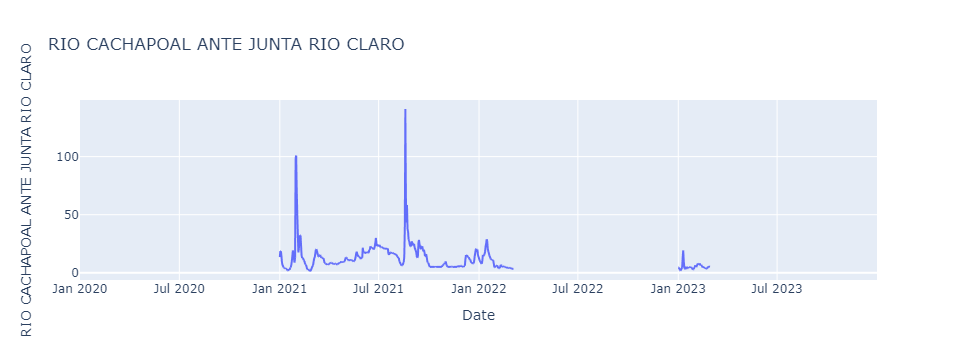

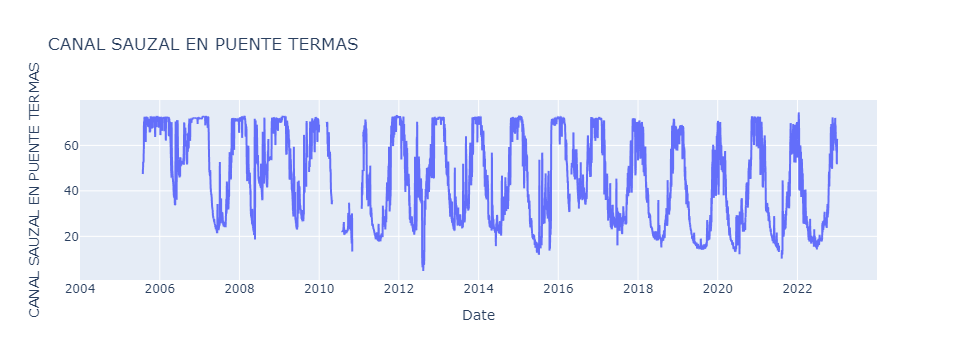

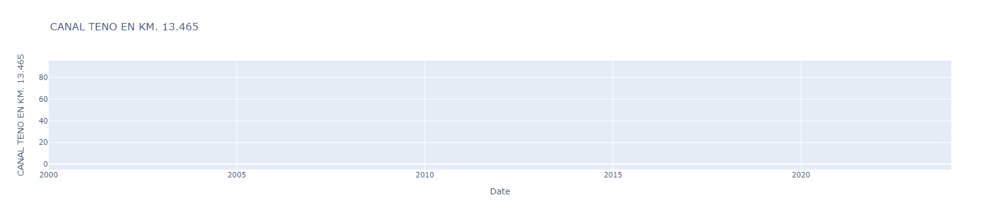

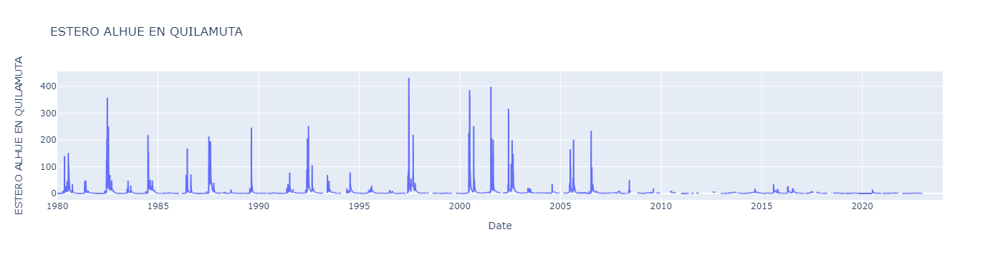

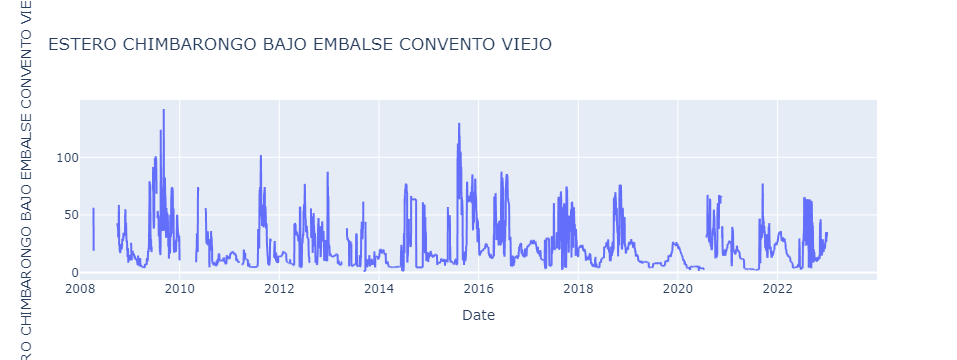

...

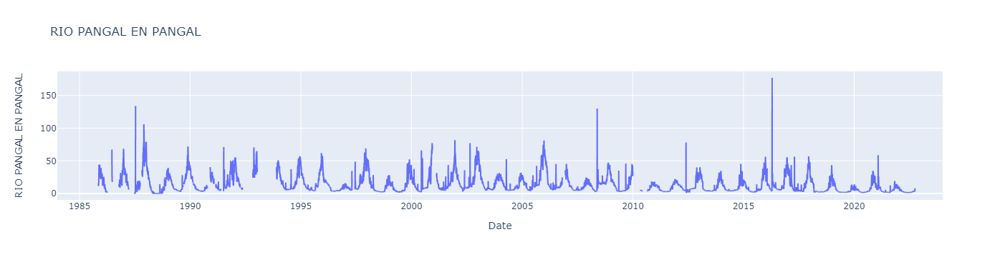

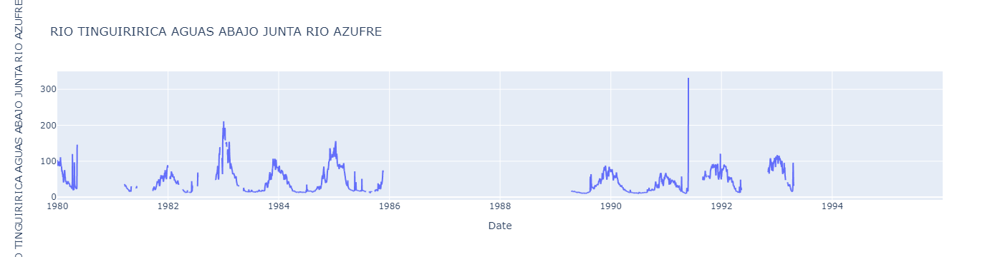

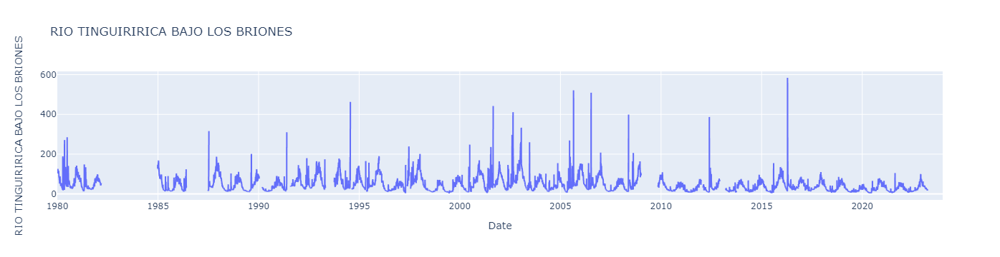

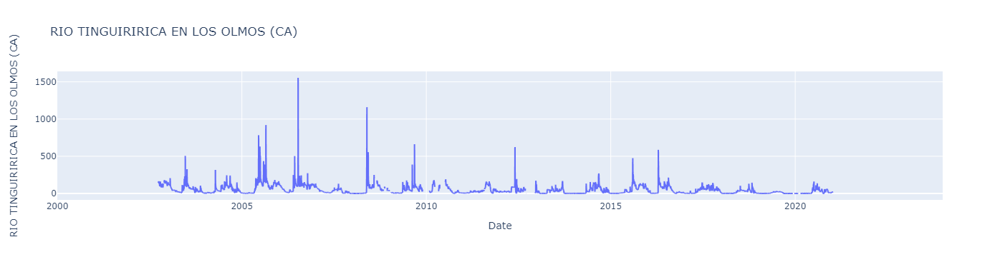

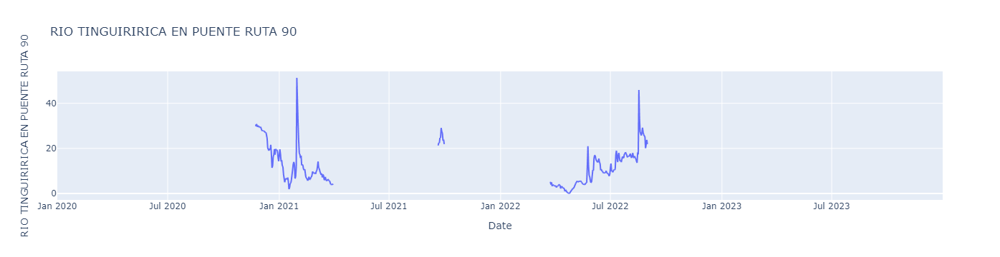

In [2]:
path = glob.glob("/media/phi/Hard_disk/Projects/MHC3/Base_datos/Ohiggins/Caudales/processed/*.xlsx")

for i in range(len(path)):
    station = pd.read_excel(path[i])
    date = pd.to_datetime(station["Date"])

    name = station.columns[1]
    correc_date = []
    station_data = []

    for x in range(station.shape[0]):
        if str(station.iloc[x,0]) != "NaT":
            correc_date.append(station.iloc[x,0])
            station_data.append(station.iloc[x,1])
            #print(station.iloc[i,0])

    final_t = pd.DataFrame(correc_date)
    final_t[str(name)] = station_data

    final_t.columns = ["Date",str(name)]
    final_t.index = final_t["Date"]

    final_t =  final_t.drop(final_t.columns[0],axis=1)
    final_t

    #print(i)
    
    date_station = pd.to_datetime(correc_date)
    all_dates = pd.date_range(date_station[0],date_station[len(date_station)-1], freq="d")
    # See left 
    fechas_faltantes = all_dates[~all_dates.isin(date_station)]
    #print(len(all_dates),final_t.shape[0])
    
    if len(date_station) != len(all_dates):
        complete = pd.DataFrame({"Date":all_dates})
        complete = complete.merge(final_t,on="Date",how="left")
        complete.index = complete["Date"]
        complete =  complete.drop(complete.columns[0],axis=1)
        final_t = complete
        
    #print(len(all_dates),final_t.shape[0])
        
    #final_t.to_csv("/media/phi/Hard_disk/Projects/MHC3/Base_datos/Ohiggins/Caudales/processed/output//"+str(name)+".csv")
    
    fig = px.line(final_t, x=final_t.index, y=str(name), title=str(name))
    fig.show()

## Second part

In [29]:
path = glob.glob("/media/phi/Hard_disk/Projects/MHC3/Base_datos/Ohiggins/Caudales/processed/output/*.csv")

stations = []

for i in range(len(path)):
    station = pd.read_csv(path[i])
    station.iloc[:0] = pd.to_datetime(station.iloc[:,0])
    name = station.columns[1]
    if i == 1:
        merged = station
    else:
        stations.append(station)
        
for sta in stations:
    merged = pd.merge(merged, sta, on="Date", how='outer')
    
merged = merged.sort_values(by="Date")

#merged.to_csv("/media/phi/Hard_disk/Projects/MHC3/Base_datos/Ohiggins/Caudales/Fluvio_DGA_R-OHiggins.csv",index=False)